## Imports

In [59]:
import sys; sys.path.insert(0, '..')
from pydub import AudioSegment
from pydub.playback import play
import numpy as np
import IPython.display as ipd
import librosa
import librosa.display
import soundfile as sf

from scipy.io import wavfile
from scipy.signal import butter, lfilter, freqz
import matplotlib.pyplot as plt

In [60]:
import audioext.audio.audio_utils as audio_utils
import audioext.audio.audio_processer as audio_processer
import audioext.audio.audio_segmenter as audio_segmenter

## Load

In [3]:
xeno_path = "/home/cvillela/dataland/data/xenocanto/samples/recordings"
wav_list = audio_utils.list_wavs_from_dir(xeno_path)
len(wav_list)
# audio_utils.get_len_wavs(wav_list)
audio = AudioSegment.from_file(wav_list[0])
audio = audio.set_channels(1)
len(audio) # in ms

35400

In [4]:
wav_list[0]

'/home/cvillela/dataland/data/xenocanto/samples/recordings/329208.wav'

In [5]:
bird_times = [[1, 2], [5, 7], [9, 10], [12, 14], [16, 18], [20, 22], [24, 25], [28, 29], [32, 33]]

### Test Conversion

In [6]:
norm_audio = audio_processer.normalize_loudness(audio)

In [7]:
audio

In [8]:
norm_audio

In [9]:
y = audio_processer.audiosegment_to_ndarray_32(audio)
y_norm = audio_processer.audiosegment_to_ndarray_32(norm_audio)
y_unit = audio_processer.normalize_unit(y)

In [10]:
ipd.Audio(y, rate=audio.frame_rate)

In [11]:
ipd.Audio(y_norm, rate=audio.frame_rate)

In [12]:
ipd.Audio(y_unit, rate=audio.frame_rate)

In [13]:
recreated_audio = audio_processer.ndarray32_to_audiosegment(y, audio.frame_rate)

In [14]:
recreated_audio

## Visualize

### Functions

In [41]:
def plot_time(signal, sr, x_lim=[None, None], y_lim=[None, None], highlighted_areas=None):

    fig, ax = plt.subplots(1, 1, figsize=(14, 4))

    x = [i/sr for i in range(len(signal))]
    y = signal

    ax.plot(x, y)
    ax.set_xlabel('Tempo [s]', size='large')
    ax.set_ylabel('Amplitude', size='large')

    ax.set_xlim(x_lim)
    ax.set_ylim(y_lim)
    if highlighted_areas is not None:
        for i, area in enumerate(highlighted_areas):
            ax.axvspan(area[0], area[1], facecolor='r', alpha=0.3, label="_"*i + "perceived bird song")
    plt.legend()
    plt.setp(ax.get_xticklabels(), rotation=0, horizontalalignment='right')

    plt.show()

In [42]:
def plot_spectrogram(Y, hop_length, sr, y_axis="linear", title='', save=False, filename='', highlighted_areas = None):
  fig, ax = plt.subplots(figsize=(10, 5))
  img=librosa.display.specshow(Y,
                            hop_length=hop_length,
                            x_axis="time",
                            y_axis=y_axis,
                            sr=sr)
  fig.colorbar(img, format="%+2.f dB")
  ax.set_title(title, fontsize=20)

  times = librosa.times_like(Y)
  if highlighted_areas is not None:
        for i, area in enumerate(highlighted_areas):
            ax.axvspan(area[0], area[1], facecolor='r', alpha=0.3, label="_"*i + "perceived bird song")


  if save:
      plt.savefig('./'+filename+title+'.png')


In [43]:
def plot_fft(signal, sr, title="FFT"):
  fig, ax = plt.subplots(figsize = (10, 5))

  signal -= signal.mean()
  fft = np.fft.fft(signal)

  # take only first half
  fft = fft[:int(len(fft)/2)]

  # remove 0Hz component - ct
  mag = np.abs(fft)
  freq = np.linspace(0, sr, len(mag))

  ax.set_title(title)
  plt.plot(freq, mag)
  plt.xlabel('Frequência [Hz]')
  plt.ylabel('Amplitude')

In [44]:
def get_freq_domain(y, frame_size=2048, hop_size=512):
    Y = librosa.stft(y, n_fft=frame_size, hop_length=hop_size)    
    Y_db = librosa.amplitude_to_db(np.abs(Y), ref=np.max) # convert signal amplitude to DB
    return Y_db

def get_mel_domain(y, sr, frame_size=2048, hop_size=512):
    Y_mel = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
    Y_mel = librosa.amplitude_to_db(np.abs(Y_mel), ref=np.max)
    return Y_mel

In [45]:
FRAME_SIZE = 2048
HOP_SIZE = 512
sr = audio.frame_rate

In [47]:
Y = librosa.stft(y, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
Y_db = librosa.amplitude_to_db(np.abs(Y), ref=np.max) # convert signal amplitude to DB

Y_mel = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
Y_mel = librosa.amplitude_to_db(np.abs(Y_mel), ref=np.max)

### Plots

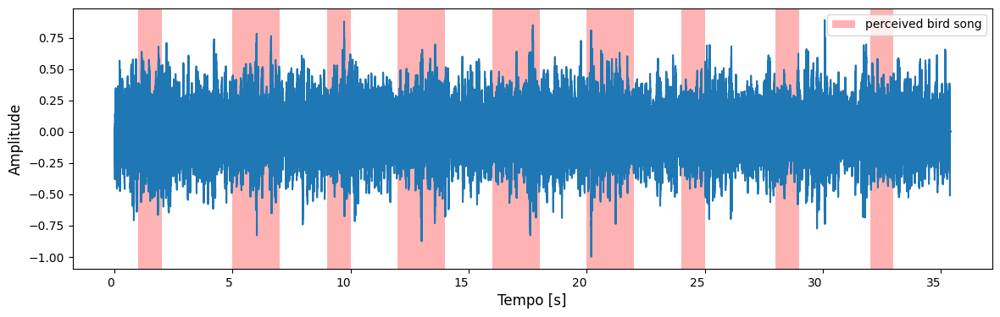

In [21]:
plot_time(y, sr, highlighted_areas=bird_times)

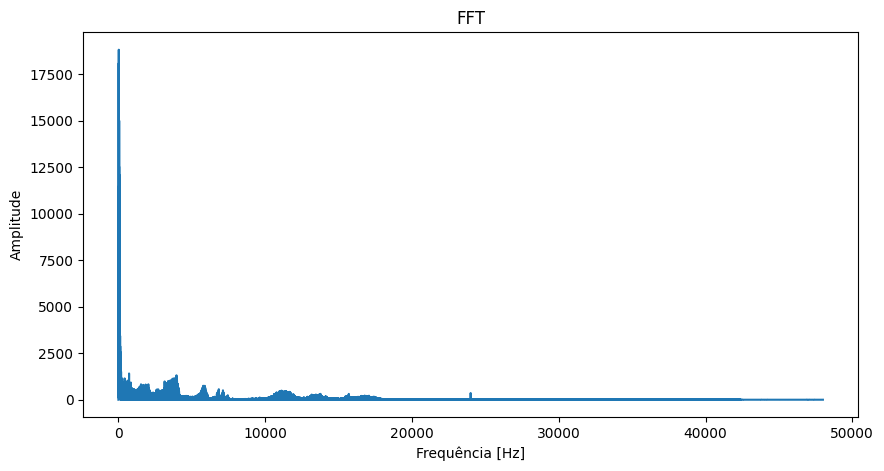

In [22]:
plot_fft(y, sr)

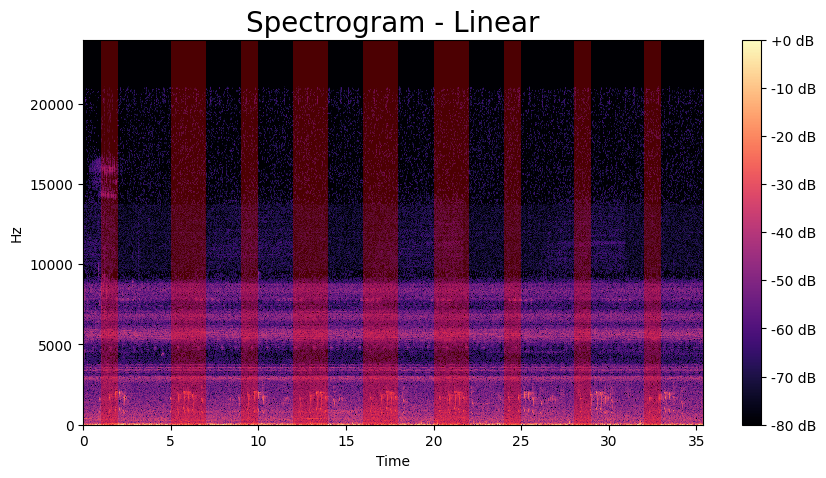

In [23]:
plot_spectrogram(Y=Y_db, sr=sr, title='Spectrogram - Linear', hop_length=HOP_SIZE, highlighted_areas=bird_times)

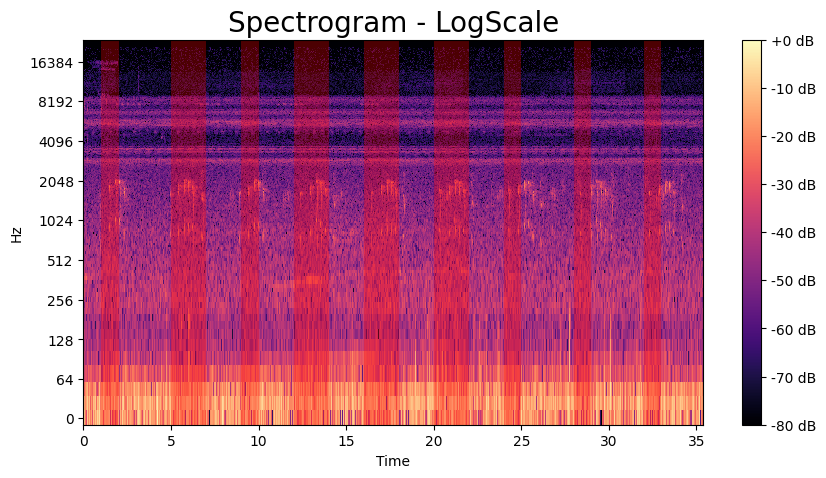

In [24]:
plot_spectrogram(Y=Y_db, sr=sr, title='Spectrogram - LogScale', hop_length=HOP_SIZE, y_axis='log', highlighted_areas=bird_times)

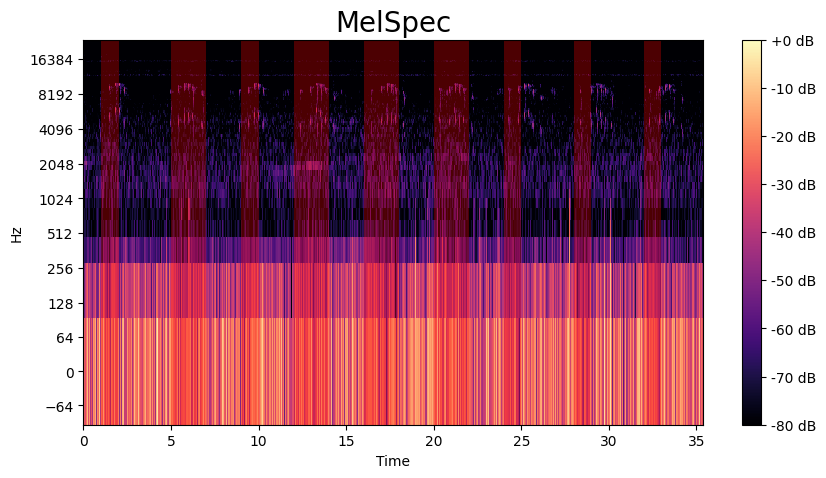

In [25]:
plot_spectrogram(Y=Y_mel, sr=sr, title='MelSpec', hop_length=HOP_SIZE, y_axis='log', highlighted_areas=bird_times)

#### Zero-Crossing-Rate

In [20]:
zcr = librosa.feature.zero_crossing_rate(y)[0]

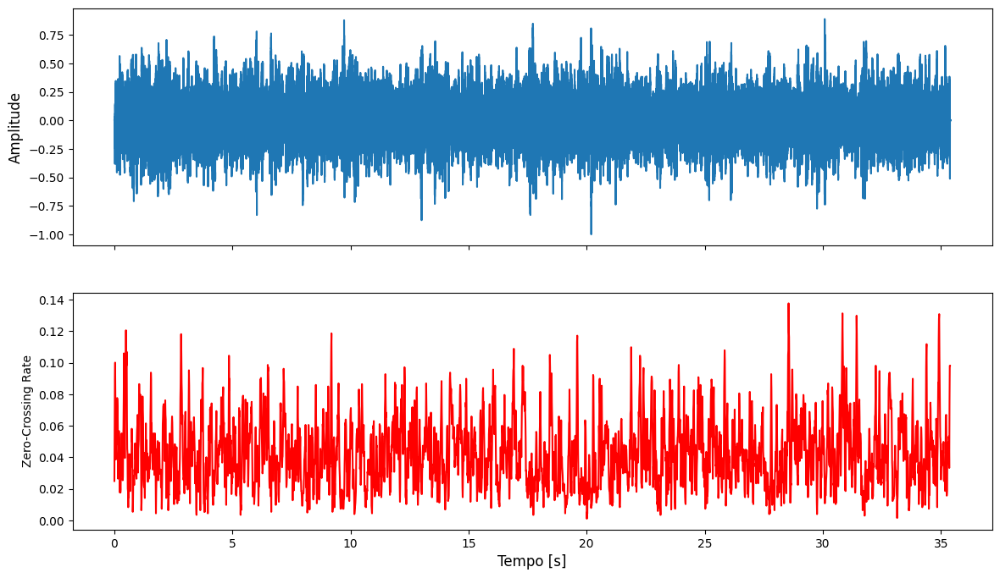

In [27]:
fig, ax = plt.subplots(2, 1, figsize=(14, 8), sharex=True)

x_time = [i/sr for i in range(len(y))]
zcr_time = np.arange(0, len(zcr)) * (len(y) / len(zcr)) / sr

ax[0].plot(x_time, y)
ax[1].plot(zcr_time, zcr, color='r')

ax[1].set_xlabel('Tempo [s]', size='large')
ax[0].set_ylabel('Amplitude', size='large')
ax[1].set_ylabel('Zero-Crossing Rate')

plt.show()

#### RMS

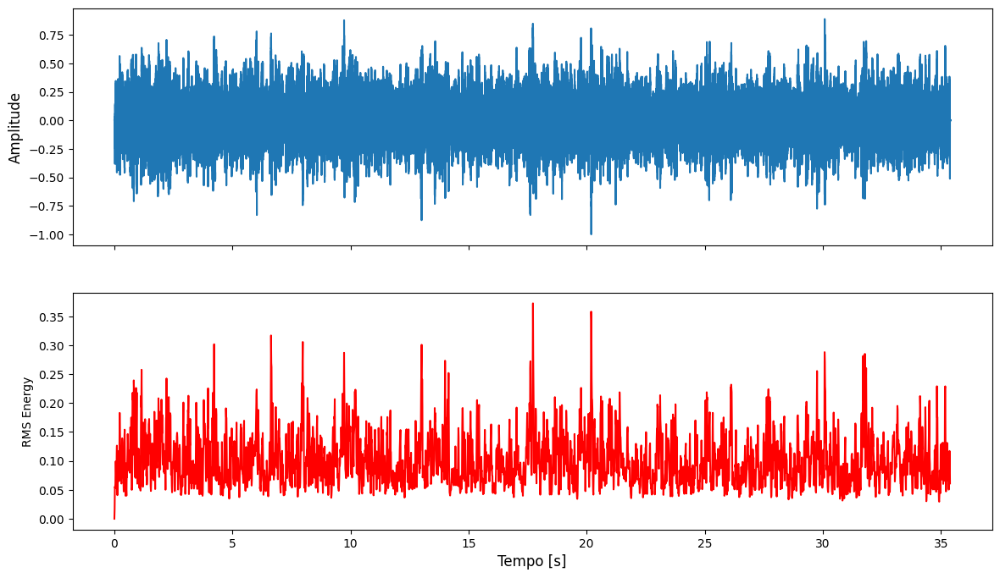

In [28]:
fig, ax = plt.subplots(2, 1, figsize=(14, 8), sharex=True)


rms = librosa.feature.rms(S=Y)[0]
x_time = [i/sr for i in range(len(y))]
rms_time = np.arange(0, len(rms)) * (len(y) / len(rms)) / sr

ax[0].plot(x_time, y)
ax[1].plot(rms_time, rms, color='r')

ax[1].set_xlabel('Tempo [s]', size='large')
ax[0].set_ylabel('Amplitude', size='large')
ax[1].set_ylabel('RMS Energy')

plt.show()

#### Spectral Centroid + Bandwidth

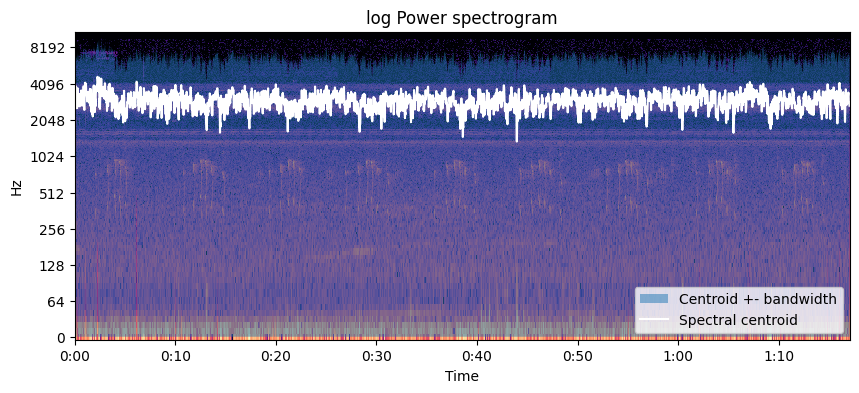

In [29]:
fig, ax = plt.subplots(1, 1, figsize=(10, 4))


cent = librosa.feature.spectral_centroid(y=y, sr=sr)[0]
spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)[0]
times = librosa.times_like(spec_bw)

x_time = [i/sr for i in range(len(y))]
cent_time = np.arange(0, len(cent)) * (len(y) / len(cent)) / sr

librosa.display.specshow(Y_db,
                         y_axis='log',
                         x_axis='time',
                        #  sr=sr
                         )
ax.set(title='log Power spectrogram')
ax.fill_between(times, np.maximum(0, cent - spec_bw),
                np.minimum(cent + spec_bw, sr/2),
                alpha=0.5, label='Centroid +- bandwidth')

# for i, area in enumerate(bird_times):
#             ax.axvspan(area[0], area[1], facecolor='r', alpha=0.3, label="_"*i + "perceived bird song")
            
ax.plot(times, cent, label='Spectral centroid', color='w')
ax.legend(loc='lower right')

plt.show()

#### Spectral Contrast

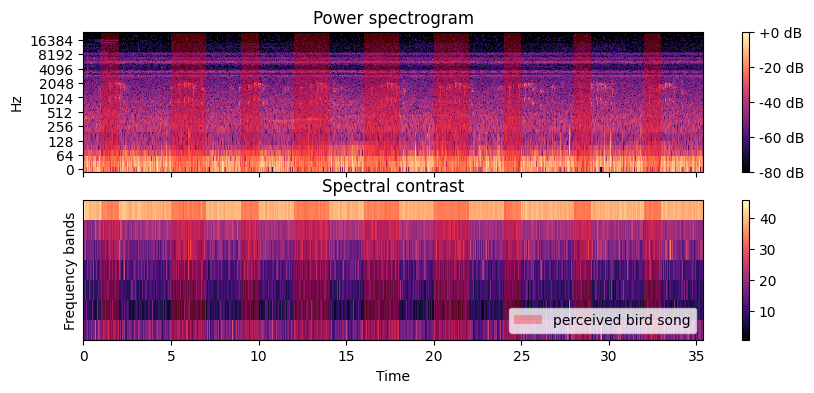

In [30]:
fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(10, 4))
img1 = librosa.display.specshow(Y_db, y_axis='log', x_axis='time', ax=ax[0], sr=sr)
fig.colorbar(img1, ax=[ax[0]], format='%+2.0f dB')
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

contrast = librosa.feature.spectral_contrast(S=np.abs(Y), sr=sr)

img2 = librosa.display.specshow(contrast, x_axis='time', ax=ax[1], sr=sr)
fig.colorbar(img2, ax=[ax[1]])
ax[1].set(ylabel='Frequency bands', title='Spectral contrast')


for i, area in enumerate(bird_times):
    for a in ax:        
        a.axvspan(area[0], area[1], facecolor='r', alpha=0.3, label="_"*i + "perceived bird song")
plt.legend(loc='lower right')

#### Spectral Flatness

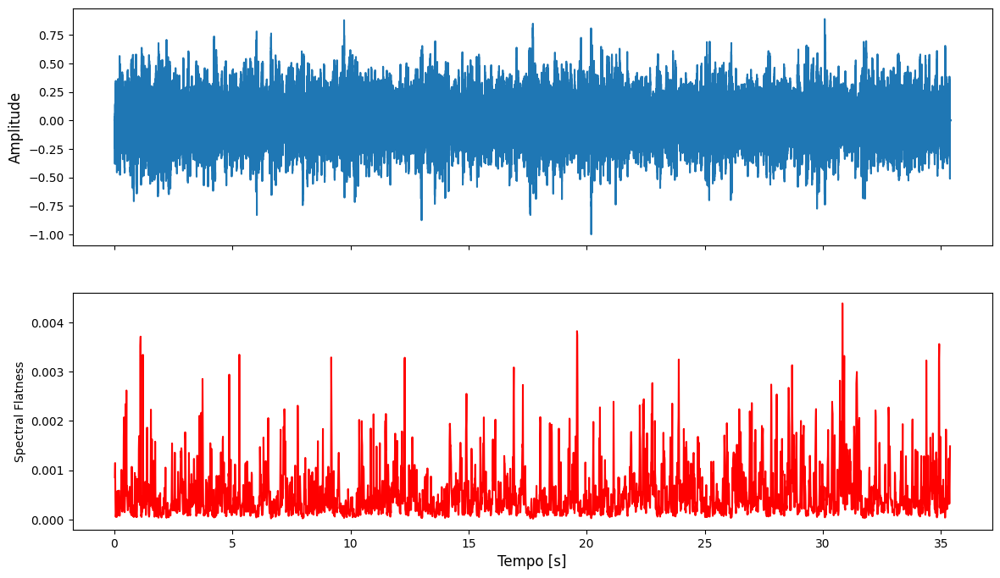

In [31]:
fig, ax = plt.subplots(2, 1, figsize=(14, 8), sharex=True)

flatness = librosa.feature.spectral_flatness(y=y)[0]

x_time = [i/sr for i in range(len(y))]
flatness_time = np.arange(0, len(flatness)) * (len(y) / len(flatness)) / sr

ax[0].plot(x_time, y)
ax[1].plot(flatness_time[2:], flatness[2:], color='r')

ax[1].set_xlabel('Tempo [s]', size='large')
ax[0].set_ylabel('Amplitude', size='large')
ax[1].set_ylabel('Spectral Flatness')

plt.show()

#### Spectral Roloff

[Text(0.5, 1.0, 'log Power spectrogram')]

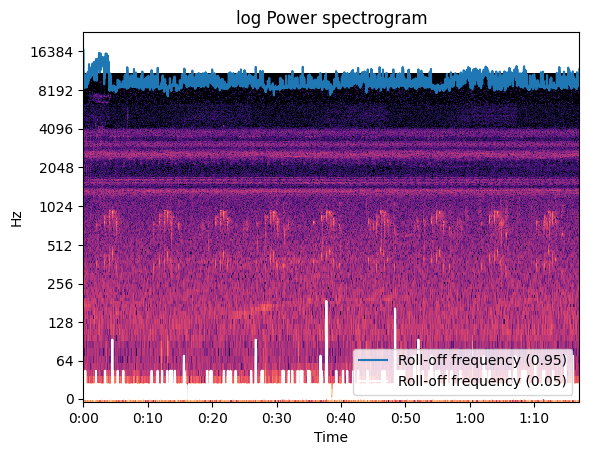

In [32]:
rolloff_max = librosa.feature.spectral_rolloff(y=y, sr=sr, roll_percent=0.95)[0]
rolloff_min = librosa.feature.spectral_rolloff(y=y, sr=sr, roll_percent=0.05)[0]

fig, ax = plt.subplots()
librosa.display.specshow(Y_db,y_axis='log', x_axis='time', ax=ax)
ax.plot(librosa.times_like(rolloff_max), rolloff_max, label='Roll-off frequency (0.95)')
ax.plot(librosa.times_like(rolloff_max), rolloff_min, color='w',
        label='Roll-off frequency (0.05)')
ax.legend(loc='lower right')
ax.set(title='log Power spectrogram')

## Denoise

### DeepFilterNet

In [33]:
from df import enhance, init_df
import torch

In [34]:
model, df_state, _ = init_df()  # Load default model

2023-09-21 16:50:02 | INFO     | DF | Running on torch 2.0.1
2023-09-21 16:50:02 | INFO     | DF | Running on host hal-9002
2023-09-21 16:50:02 | INFO     | DF | Loading model settings of DeepFilterNet3
2023-09-21 16:50:02 | INFO     | DF | Using DeepFilterNet3 model at /home/cvillela/.cache/DeepFilterNet/DeepFilterNet3
2023-09-21 16:50:02 | INFO     | DF | Initializing model `deepfilternet3`


fatal: not a git repository (or any of the parent directories): .git


2023-09-21 16:50:03 | INFO     | DF | Found checkpoint /home/cvillela/.cache/DeepFilterNet/DeepFilterNet3/checkpoints/model_120.ckpt.best with epoch 120
2023-09-21 16:50:03 | INFO     | DF | Running on device cuda:0
2023-09-21 16:50:03 | INFO     | DF | Model loaded


In [35]:
denoised_y = enhance(model, df_state, torch.tensor(np.expand_dims(y, axis=0))).numpy().squeeze(axis=0)

/home/cvillela/anaconda3/envs/ras_audio/lib/python3.11/site-packages/torch/nn/modules/conv.py:459: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1682343995622/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


In [36]:
y.shape

(1699200,)

In [37]:
denoised_y.shape

(1699200,)

In [38]:
ipd.Audio(denoised_y, rate=sr)

In [39]:
ipd.Audio(y, rate=sr)

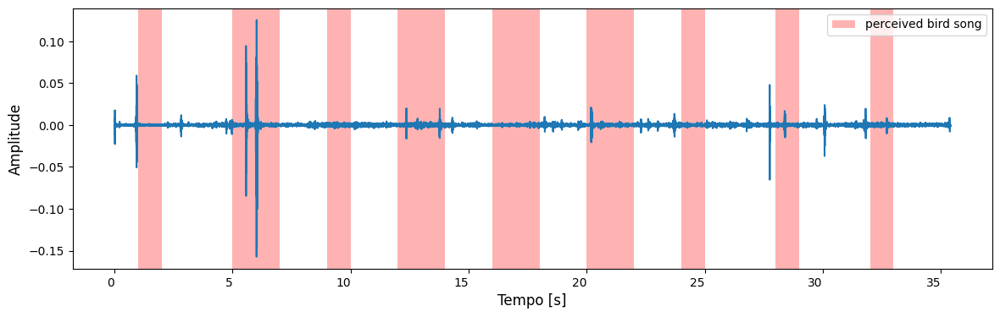

In [40]:
plot_time(denoised_y, sr, highlighted_areas=bird_times)

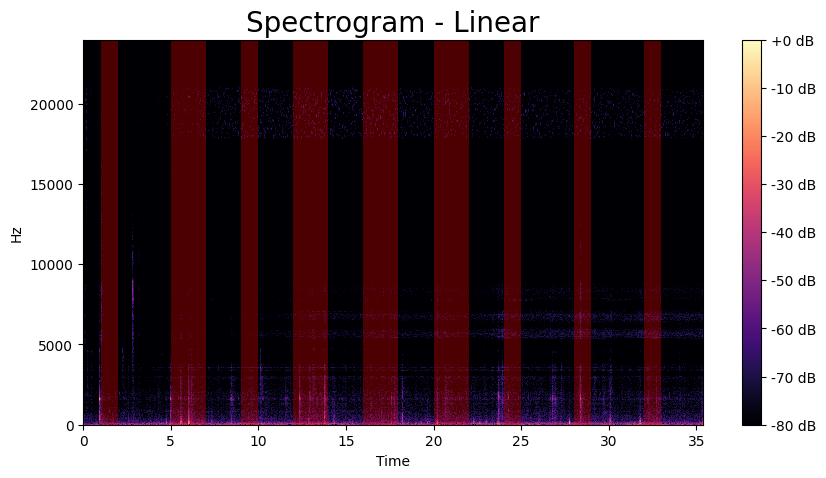

In [41]:
plot_spectrogram(Y=get_freq_domain(denoised_y), sr=sr, title='Spectrogram - Linear', hop_length=HOP_SIZE, highlighted_areas=bird_times)

### NoiseReduce

In [80]:
import noisereduce as nr

In [81]:
y.shape

(1699200,)

In [82]:
# reduce za noise
y_red = nr.reduce_noise(y=y, sr=sr, stationary=True)
y_red_later = nr.reduce_noise(y=y_lp_first, sr=sr, stationary=True)

In [83]:
y.shape

(1699200,)

In [84]:
y_red.shape

(1699200,)

In [85]:
Y_red=get_freq_domain(y_red)
Y_red_later=get_freq_domain(y_red_later)

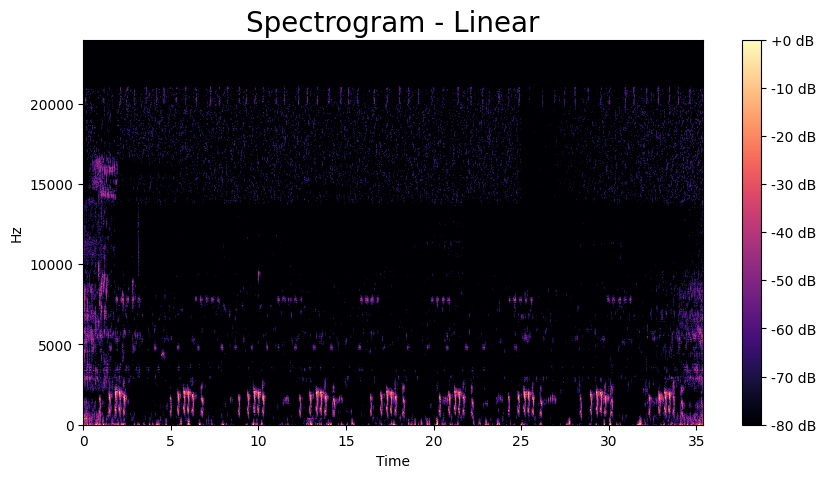

In [39]:
plot_spectrogram(Y_red, sr=sr, title='Spectrogram - Linear',y_axis="linear", hop_length=HOP_SIZE)
wavfile.write('reduced_noise.wav', sr, y_red)
ipd.Audio(y_red, rate=sr)

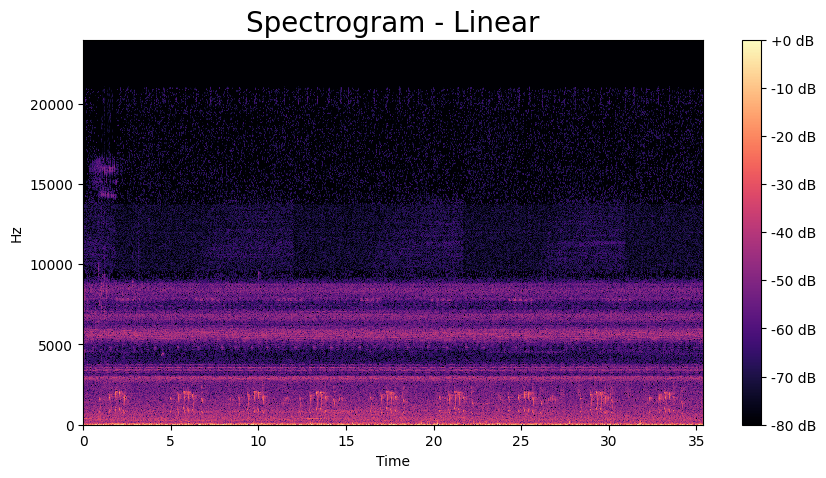

In [48]:
plot_spectrogram(Y_db, sr=sr, title='Spectrogram - Linear',y_axis="linear", hop_length=HOP_SIZE, save=True)
wavfile.write('noisy.wav', sr, y)
ipd.Audio(y, rate=sr)

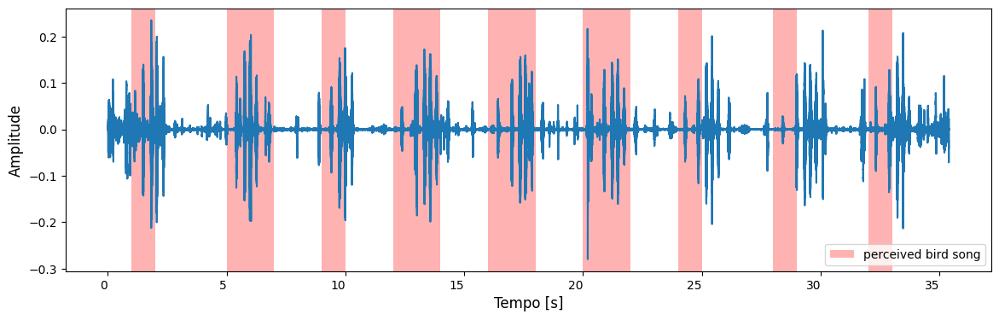

In [31]:
plot_time(y_red, sr, highlighted_areas=bird_times)

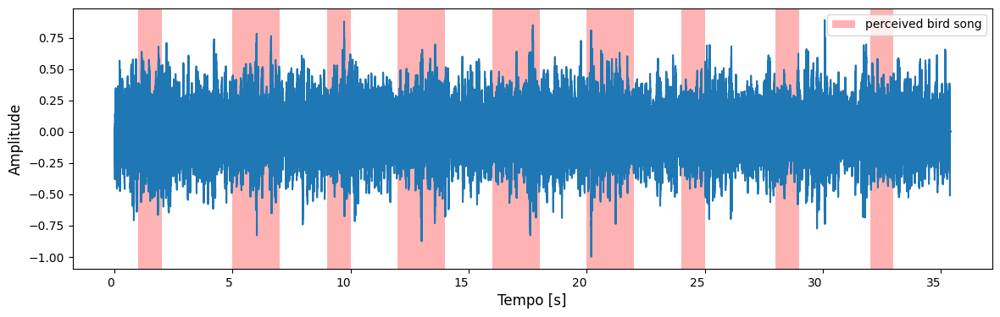

In [32]:
plot_time(y, sr, highlighted_areas=bird_times)

In [73]:
def butter_lowpass(cutoff, fs, order):
    return butter(order, cutoff, fs=fs, btype='low', analog=False)

def butter_lowpass_filter(data, cutoff, fs, order):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

def lowpass_filter_signal(y, sr, order=6, cutoff = 15000, plot_filter=True):

    fs = sr
    
    # Get the filter coefficients so we can check its frequency response.
    b, a = butter_lowpass(cutoff, fs, order)

    # Plot the frequency response.
    if plot_filter:
        w, h = freqz(b, a, fs=fs, worN=8000)
        plt.subplot(2, 1, 1)
        plt.plot(w, np.abs(h), 'b')
        plt.plot(cutoff, 0.5*np.sqrt(2), 'ko')
        plt.axvline(cutoff, color='k')
        plt.xlim(0, 0.5*fs)
        plt.title("Lowpass Filter Frequency Response")
        plt.xlabel('Frequency [Hz]')
        plt.grid()
    
    # Filter the data
    y_lp = butter_lowpass_filter(y, cutoff, fs, order)
    return y_lp

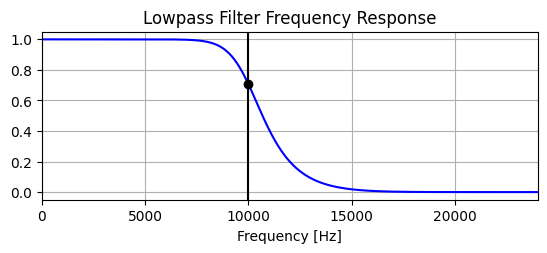

In [78]:
y_lp_first = lowpass_filter_signal(y, sr, order=6, cutoff = 10000, plot_filter=True)

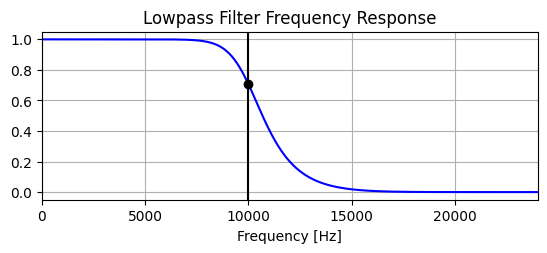

In [75]:
y_lp = lowpass_filter_signal(y_red, sr, order=6, cutoff = 10000, plot_filter=True)

In [79]:
Y_lp_first = get_freq_domain(y_lp_first)
Y_lp = get_freq_domain(y_lp)

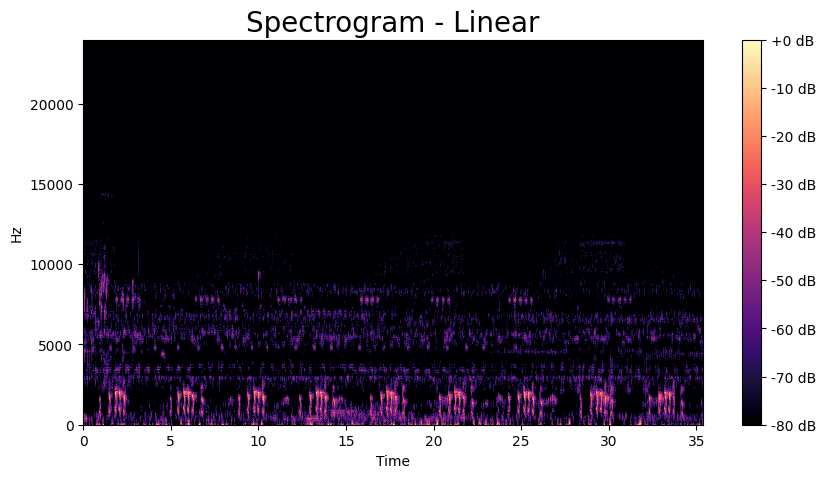

In [77]:
plot_spectrogram(Y_lp, sr=sr, title='Spectrogram - Linear',y_axis="linear", hop_length=HOP_SIZE)
wavfile.write('reduced_noise_lowpass.wav', sr, y_lp)
ipd.Audio(y_lp, rate=sr)

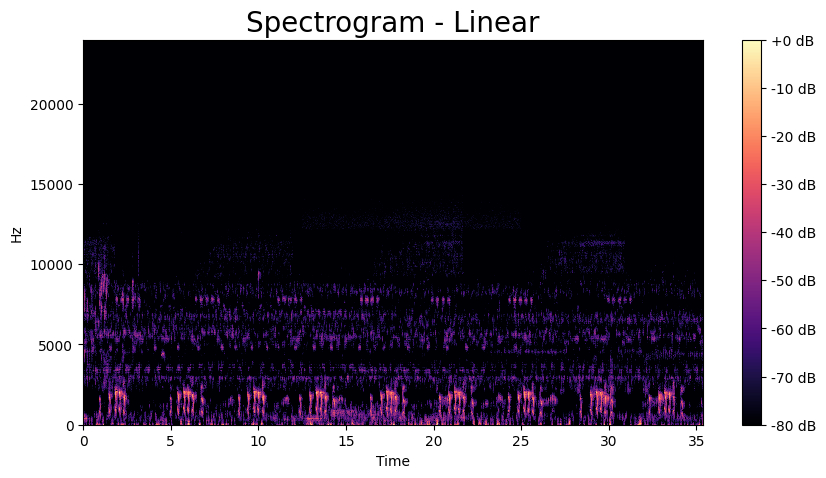

In [ ]:
plot_spectrogram(Y_red_later, sr=sr, title='Spectrogram - Linear',y_axis="linear", hop_length=HOP_SIZE)
wavfile.write('reduced_noise_after.wav', sr, y_red_later)
ipd.Audio(y_red_later, rate=sr)

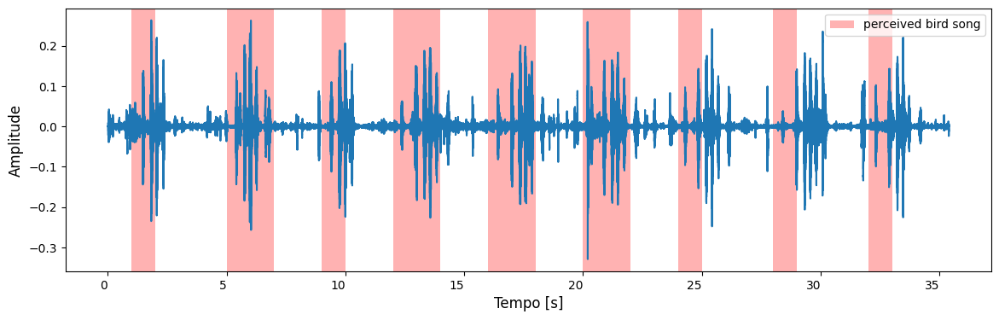

In [56]:
plot_time(y_lp, sr, highlighted_areas=bird_times)

## Remove Silence

In [4]:
from pydub.silence import split_on_silence

In [5]:
audio_chunks = split_on_silence(
    audio,
    min_silence_len = 2000,
    silence_thresh = -45,
    keep_silence = 500,)

audio_nonsilent = sum(audio_chunks)

In [7]:
audio

In [6]:
audio_nonsilent

In [21]:
audio_nonsilent = AudioSegment
for [start, end] in silences:
    curr_seg = audio[start:end]
    audio_nonsilent = audio_nonsilent + curr_seg

TypeError: Gains must be the second addend after the AudioSegment

In [12]:
audio_nonsilent = audio[0:silences[0][0]] + audio[0:silences[0][1]] + audio[0:silences[1][0]] + audio[0:silences[1][1]]

In [13]:
audio.dBFS

-29.87694437862951

In [14]:
audio_nonsilent.dBFS

-29.340162628186267

In [15]:
audio[:1000]